<a href="https://colab.research.google.com/github/AaryaDesai1/Stable_Diffusion_Finetuning/blob/main/textual_inversion.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Implementing Textual inversion

## Set up

In [ ]:
!git clone https://github.com/huggingface/diffusers

Cloning into 'diffusers'...
remote: Enumerating objects: 76573, done.
remote: Counting objects: 100% (1375/1375), done.
remote: Compressing objects: 100% (659/659), done.
remote: Total 76573 (delta 899), reused 996 (delta 603), pack-reused 75198 (from 1)
Receiving objects: 100% (76573/76573), 54.68 MiB | 16.76 MiB/s, done.
Resolving deltas: 100% (56654/56654), done.


In [ ]:
cd diffusers

/content/diffusers


In [ ]:
pip install .

Processing /content/diffusers
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for diffusers: filename=diffusers-0.32.0.dev0-py3-none-any.whl size=3087624 sha256=c8c983839e2da62e7b30695ac7fd2687de98b02f1ef2b6627c3dc46d149364f2
  Stored in directory: /tmp/pip-ephem-wheel-cache-gcgfku3z/wheels/95/c5/3b/e1b4269f8a2584de57e75f949a185b48fc4144e9a91fc9965a
Successfully built diffusers
  Attempting uninstall: diffusers
    Found existing installation: diffusers 0.31.0
    Uninstalling diffusers-0.31.0:
      Successfully uninstalled diffusers-0.31.0


In [ ]:
cd examples/textual_inversion

/content/diffusers/examples/textual_inversion


In [ ]:
pip install -r requirements.txt

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 3.1 MB/s eta 0:00:00


In [ ]:
!accelerate config default

accelerate configuration saved at /root/.cache/huggingface/accelerate/default_config.yaml


In [ ]:
from huggingface_hub import notebook_login

notebook_login()

In [ ]:
mkdir ./fantasy

In [ ]:
import os

os.environ['MODEL_NAME'] = 'stable-diffusion-v1-5/stable-diffusion-v1-5'
os.environ['DATA_DIR'] = './fantasy'


In [ ]:
pwd

'/content/diffusers/examples/textual_inversion'

# Parameters:
Based on the paper that we followed (), the parameters were set as stated below:

**NOTE: the following needs to be changed to these after running one model with the defaults, i.e., 1, 1, 0.005.**

There is a relationship between the `train_batch_size` and `gradient_accumulation_steps` used based on the number of images you want to use to personalize your SD model. For example, if you use 10 (which we are), then you should use 2*5 respectively (since = 10).
1. `train_batch_size`: 2
2. `gradient_accumulation_steps`: 5
The learning rate needs to be changed according to the two parameters above, where the ideal learning rate mentioned in the paper is 0.005. However, this needs to be changed according to the batch size, i.e., multiplied with its value. Therefore,
3. `learning_rate`: 0.01
The number of vectors refers to how many vectors you want your placeholder token to be treated as. Since we are looking at fantasy style images, and fantasy is 1 token, the paper suggests to maintain the same number for the token we specify as well.
4. `num_vectors`: 1

Other parameters to change:

For preprocessing:
- Create flipped copies
- Resize all to 512
- Use BLIP for caption.

For training:
- (from above)
- Gradient clipping disabled
- Save an image to log directory every 100 steps (same for copy of embedding)
- Latent sampling method: paper says 'once' but the video said that an updated paper suggests 'deterministic'

In [ ]:
import pandas as pd
import os

# Create a DataFrame to store training logs
log_df = pd.DataFrame(columns=['Step', 'Training Loss', 'Validation Loss'])

# Custom function to log data
def log_to_csv(step, train_loss, val_loss, log_file='training_logs.csv'):
    log_data = {'Step': step, 'Training Loss': train_loss, 'Validation Loss': val_loss}
    global log_df
    log_df = log_df.append(log_data, ignore_index=True)
    log_df.to_csv(log_file, index=False)  # Save log to CSV file

# Training loop modification
for step in range(1, max_train_steps+1):
    # Your existing training code goes here...

    # Get training loss (ensure this is correct based on your code)
    loss = model(**train_batch).loss

    # Calculate validation loss after training for the specified steps
    if step % validation_steps == 0:
        model.eval()
        val_loss = 0.0
        for val_batch in validation_dataloader:
            with torch.no_grad():
                val_loss += model(**val_batch).loss.item()
        avg_val_loss = val_loss / len(validation_dataloader)
        model.train()  # Switch back to training mode

        # Log the training and validation losses
        log_to_csv(step, loss.item(), avg_val_loss)

    # Optionally, add other things like saving checkpoints, etc.
    if step % save_steps == 0:
        model.save_pretrained(output_dir)

In [ ]:
!accelerate launch textual_inversion.py \
  --pretrained_model_name_or_path=$MODEL_NAME \
  --train_data_dir=$DATA_DIR \
  --learnable_property="style" \
  --placeholder_token="fantasium" \
  --num_vectors=1 \
  --initializer_token="fantasy" \
  --resolution=512 \
  --train_batch_size=1 \
  --gradient_accumulation_steps=4 \
  --max_train_steps=1000 \
  --learning_rate=0.001 \
  --scale_lr \
  --lr_scheduler="constant" \
  --lr_warmup_steps=0 \
  --output_dir="fantasium_base" \
  --push_to_hub \
  --validation_prompt="A fantasium scene" \
  --num_validation_images=4 \
  --validation_steps=100


2024-12-05 03:22:31.858958: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-12-05 03:22:31.873397: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-05 03:22:31.892477: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-05 03:22:31.898307: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-05 03:22:31.912575: I tensorflow/core/platform/cpu_feature_guar

In [ ]:
import pandas as pd
from diffusers import AutoPipelineForText2Image
import torch
from PIL import Image
from IPython.display import display

# Load your fine-tuned pipeline
pipeline = AutoPipelineForText2Image.from_pretrained(
    "stable-diffusion-v1-5/stable-diffusion-v1-5",
    torch_dtype=torch.float16
).to("cuda")
pipeline.load_textual_inversion("aad64/fantasium_base")

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

learned_embeds.safetensors:   0%|          | 0.00/3.18k [00:00<?, ?B/s]

The new embeddings will be initialized from a multivariate normal distribution that has old embeddings' mean and covariance. As described in this article: https://nlp.stanford.edu/~johnhew/vocab-expansion.html. To disable this, use `mean_resizing=False`



**Prompt**: Two fantasium hobbits carrying sacks, walking with sticks in green pastures, dark forested mountains in the background.
**Subject**: Lord of the Rings, **Length**: concise


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

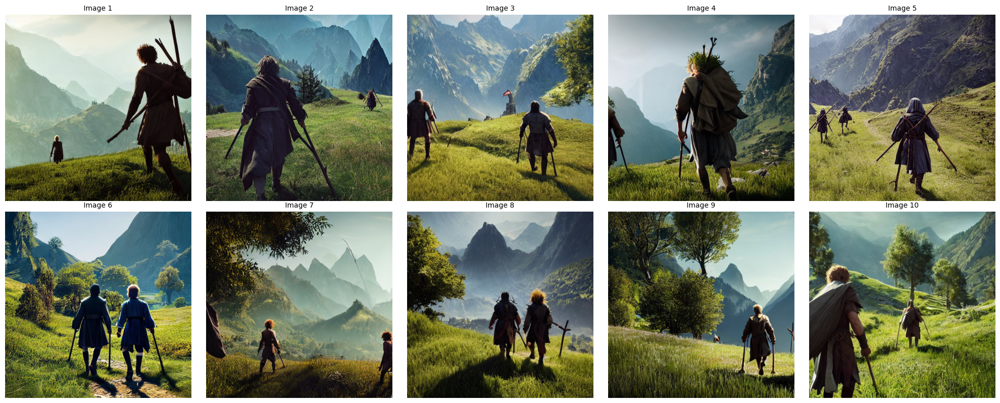


**Prompt**: Two fantasium hobbits carrying brown sacks, walk away from the camera with sticks through lush green pastures. Behind them, dark, forested mountains rise under a moody, overcast sky. A cinematic wide-angle shot with diffused lighting with a vintage fantasy aesthetic.
**Subject**: Lord of the Rings, **Length**: medium


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

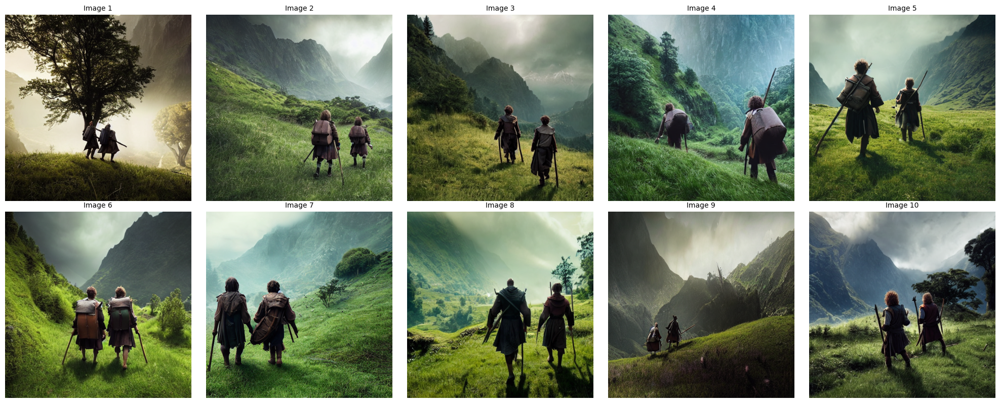

Token indices sequence length is longer than the specified maximum sequence length for this model (95 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['their windswept curly hair and steady pace capture their courage as they journey into the unknown .']



**Prompt**: Two fantasium hobbits walk away, carrying large sticks and wearing earth-toned clothing with weathered sacks. Behind them rise dark, forested mountains under a cloudy sky. The wide-angle shot emphasizes their small size, with diffused light creating a cinematic, vintage fantasy feel. One strides ahead confidently, gripping a stick, while the other lags behind slightly. Their windswept curly hair and steady pace capture their courage as they journey into the unknown.
**Subject**: Lord of the Rings, **Length**: long


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['their windswept curly hair and steady pace capture their courage as they journey into the unknown .']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['their windswept curly hair and steady pace capture their courage as they journey into the unknown .']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['their windswept curly hair and steady pace capture their courage as they journey into the unknown .']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['their windswept curly hair and steady pace capture their courage as they journey into the unknown .']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['their windswept curly hair and steady pace capture their courage as they journey into the unknown .']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['their windswept curly hair and steady pace capture their courage as they journey into the unknown .']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['their windswept curly hair and steady pace capture their courage as they journey into the unknown .']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['their windswept curly hair and steady pace capture their courage as they journey into the unknown .']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['their windswept curly hair and steady pace capture their courage as they journey into the unknown .']


  0%|          | 0/50 [00:00<?, ?it/s]

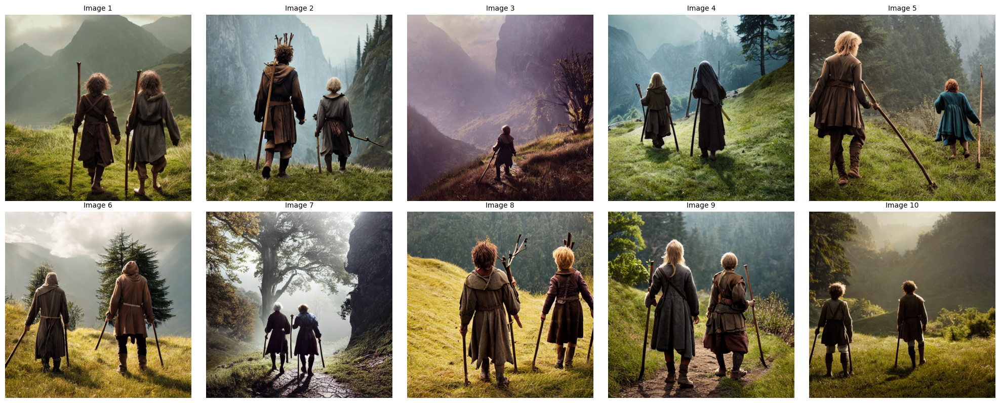


**Prompt**: An young fantasium human cautiously reaches out to touch a mysterious black dragon in a peaceful forest glade.
**Subject**: Train a Dragon, **Length**: concise


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

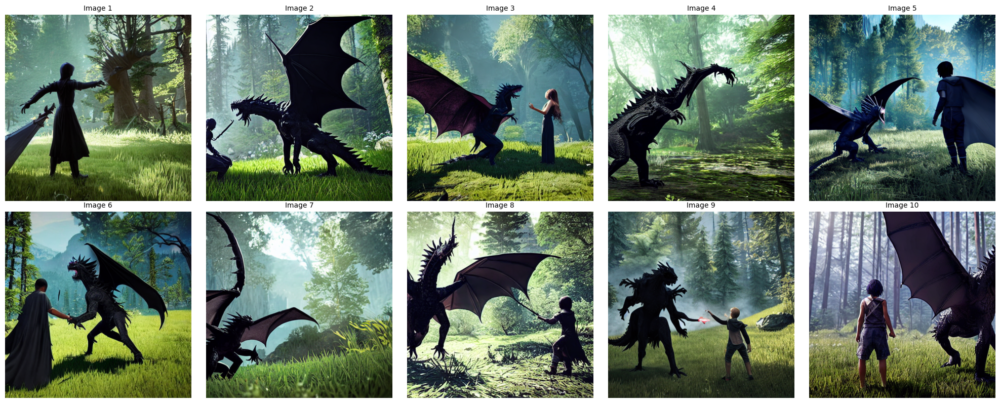


**Prompt**: A fantasium boy with a fur vest reaches out to touch black dragon in a tranquil forest clearing. The dragon has curious, expressive eyes with smooth slim scales. A 3D animated style with realistic yet detailed textures, characteristic of high-quality CGI.  The composition uses a cinematic, medium-close shot, capturing both characters in the frame and highlighting their interaction."
**Subject**: Train a Dragon, **Length**: medium


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

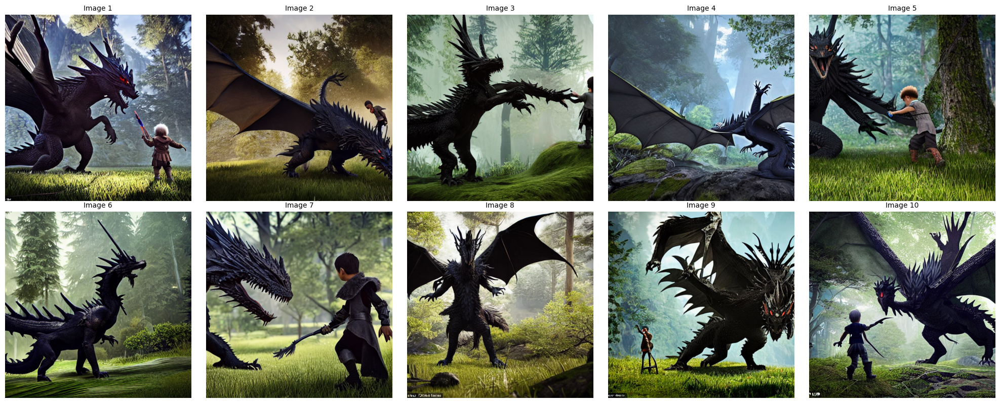

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['emphasizes trust and connection , showcasing detailed cgi textures and a cinematic aesthetic characteristic of high - quality animation .']



**Prompt**: A fantasium boy in a fur vest reaches toward a sleek black dragon with big sweet eyes, their connection forming as his hand hovers near its face. The 3D animated style blends Pixar-like realism and stylized design, with rich textures and expressive details. Bright, soft lighting enhances the magical, emotional atmosphere. Captured from a close, side-facing perspective, the scene emphasizes trust and connection, showcasing detailed CGI textures and a cinematic aesthetic characteristic of high-quality animation.
**Subject**: Train a Dragon, **Length**: long


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['emphasizes trust and connection , showcasing detailed cgi textures and a cinematic aesthetic characteristic of high - quality animation .']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['emphasizes trust and connection , showcasing detailed cgi textures and a cinematic aesthetic characteristic of high - quality animation .']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['emphasizes trust and connection , showcasing detailed cgi textures and a cinematic aesthetic characteristic of high - quality animation .']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['emphasizes trust and connection , showcasing detailed cgi textures and a cinematic aesthetic characteristic of high - quality animation .']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['emphasizes trust and connection , showcasing detailed cgi textures and a cinematic aesthetic characteristic of high - quality animation .']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['emphasizes trust and connection , showcasing detailed cgi textures and a cinematic aesthetic characteristic of high - quality animation .']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['emphasizes trust and connection , showcasing detailed cgi textures and a cinematic aesthetic characteristic of high - quality animation .']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['emphasizes trust and connection , showcasing detailed cgi textures and a cinematic aesthetic characteristic of high - quality animation .']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['emphasizes trust and connection , showcasing detailed cgi textures and a cinematic aesthetic characteristic of high - quality animation .']


  0%|          | 0/50 [00:00<?, ?it/s]

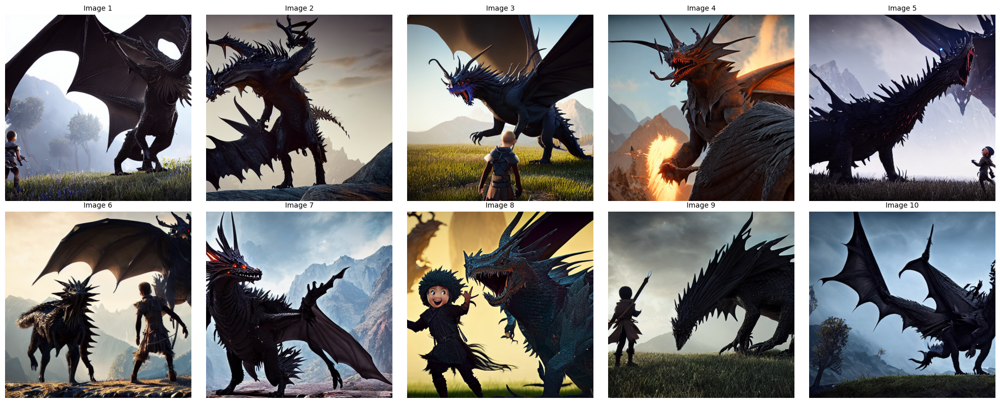


**Prompt**: A fantasium woman elf in fur-lined winter leather clothes, reading by a fire, surrounded by books, cats, and magical items in a messy library.
**Subject**: Custom World, **Length**: concise


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

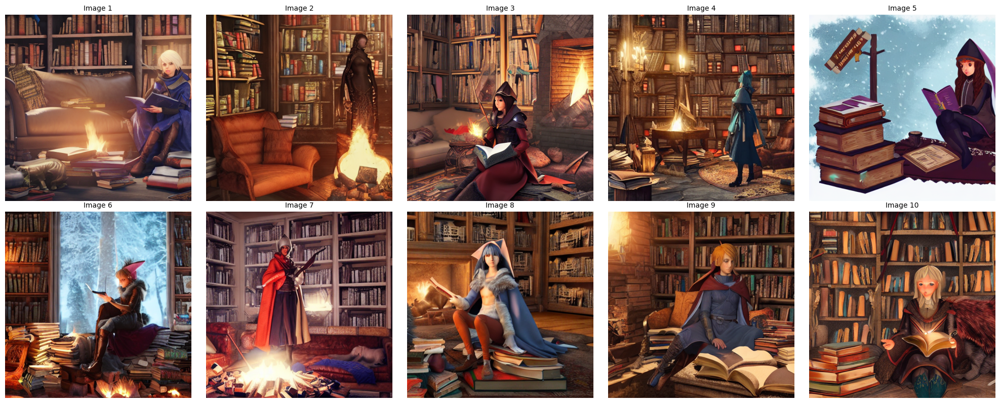


**Prompt**: A cinematic fantasy setting featuring a brown-haired fantasium high elf in fur-trimmed leather, reading a glowing book by a warm fire. The cluttered library brims with ancient tomes, magical artifacts, and curious cats, while frosted windows frame snowy mountains and a mystical forest.
**Subject**: Custom World, **Length**: medium


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

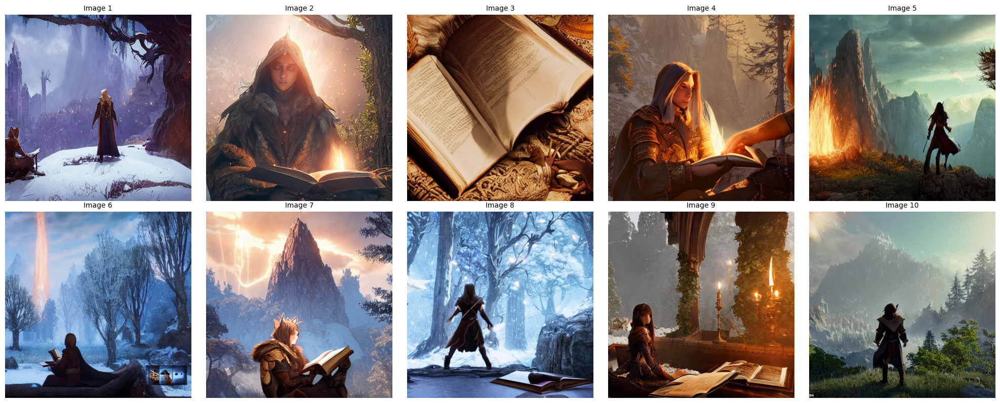

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['.']



**Prompt**: A fantasium middle-aged high elf with brown hair sits in a large, worn chair by a crackling fireplace, dressed in fur-trimmed winter adventure leathers.  Her cluttered lodge, filled with scattered books, and paper. The cinematic fantasy scene shows a blizzard outside trapping the town. The cinematic fantasy art, captures the contrast between the chaotic interior and the icy peril.
**Subject**: Custom World, **Length**: long


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['.']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['.']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['.']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['.']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['.']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['.']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['.']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['.']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['.']


  0%|          | 0/50 [00:00<?, ?it/s]

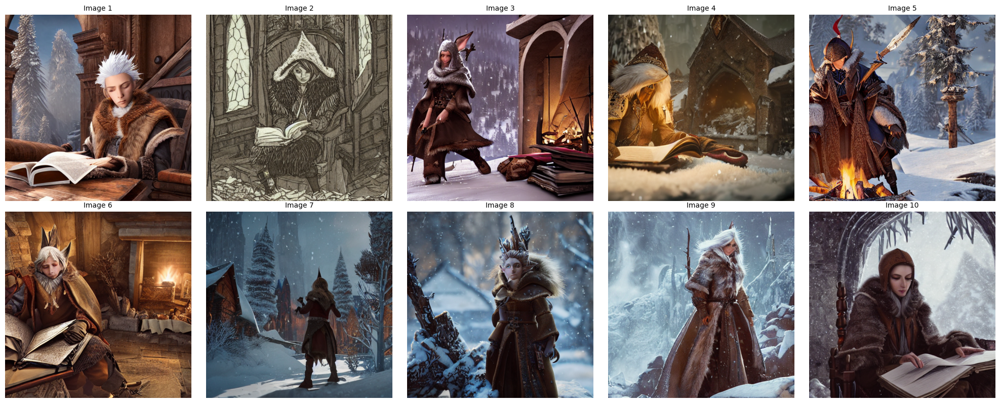

In [ ]:
import matplotlib.pyplot as plt

# Load prompts from the CSV file
csv_file = "/content/diffusers/examples/textual_inversion/Fantasy_Prompts.csv"  # Replace with your CSV file path
prompts_df = pd.read_csv(csv_file)

prompts_df = pd.read_csv(csv_file)

# Loop through each row in the CSV and generate images
for idx, row in prompts_df.iterrows():
    prompt = row["prompt"]
    length = row["length"]
    subject = row["subject"]

    print(f"\n**Prompt**: {prompt}")
    print(f"**Subject**: {subject}, **Length**: {length}")

    # Create a figure for the grid (2 rows x 5 columns)
    fig, axes = plt.subplots(2, 5, figsize=(20, 8))
    axes = axes.flatten()  # Flatten axes for easy indexing

    for i in range(10):  # Generate 10 images
        try:
            # Generate image
            image = pipeline(prompt).images[0]

            # Display the image in the grid
            axes[i].imshow(image)
            axes[i].axis("off")  # Turn off axis for cleaner display
            axes[i].set_title(f"Image {i + 1}", fontsize=10)
        except Exception as e:
            print(f"Error generating image {i + 1} for prompt {idx}: {e}")
            axes[i].axis("off")
            axes[i].set_title("Error", fontsize=10)

    # Adjust layout and show the grid
    plt.tight_layout()
    plt.show()
